# Capstone Two - Pre-processing and Training Data Development.ipynb

Now that we have cleaned the data to a point that we can work with it, let's take some time to explore the data. To remind us of our goal, we will be determining if there are any correlations between specific characteristics of our bank's cold call marketing campaigns and our prospects saying "yes" to a term deposit with the bank.

We have nearly 20 data points to explore, so let's get to it!

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
%matplotlib inline

In [2]:
pwd

'/Users/gagibitz/Documents/springboard/springboard-git/springboard/Capstone/notebooks'

In [3]:
cd ..

/Users/gagibitz/Documents/springboard/springboard-git/springboard/Capstone


In [4]:
#Load the csv files into a dataframe. Let's try it first on X_train to make sure we are looking good.
X_train = pd.read_csv('data/X_train.csv')
X_train.drop(['Unnamed: 0', 'duration'], axis=1, inplace=True)
X_train.shape

(28679, 18)

In [5]:
X_test = pd.read_csv('data/X_test.csv')
X_test.drop(['Unnamed: 0', 'duration'], axis=1, inplace=True)
X_test.shape

(9560, 18)

In [6]:
y_train = pd.read_csv('data/y_train.csv')
y_train.drop('Unnamed: 0', axis=1, inplace=True)
y_train.shape

(28679, 1)

In [7]:
y_test = pd.read_csv('data/y_test.csv')
y_test.drop('Unnamed: 0', axis=1, inplace=True)
y_test.shape

(9560, 1)

In [8]:
y_train.y.value_counts()

-0.353938    25545
 2.825353     3134
Name: y, dtype: int64

In [9]:
y_train = round(y_train, 2)

In [10]:
y_train = y_train['y'].replace({-0.35: 'Yes', 2.83: 'No'})
y_train.head()

0    Yes
1    Yes
2    Yes
3    Yes
4    Yes
Name: y, dtype: object

In [11]:
y_test = round(y_test, 2)

In [12]:
y_test = y_test.replace({-0.35: 'Yes', 2.83: 'No'})
y_test.head()

,y
0,Yes
1,Yes
2,Yes
3,Yes
4,Yes


In [13]:
# These are column-vectors, but I need y to be a 1D array.
print(type(y_train))
y_train = np.ravel(y_train)
print(type(y_train))

<class 'pandas.core.series.Series'>
<class 'numpy.ndarray'>


In [14]:
print(type(y_test))
y_test = np.ravel(y_test)
print(type(y_test))

<class 'pandas.core.frame.DataFrame'>
<class 'numpy.ndarray'>


Training and test data is in order! Let's spin up some models.

## Model Testing

This is a classic classification problem driven by supervised learning. We want to know whether a phone call will result in a simple YES or NO. Because we have a decently-sized training set, I'd like to compare these three models:
- Linear Regression
- Simple Decision Tree
- Random Forest

#### LOGISTIC REGRESSION

In [15]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

In [16]:
clf = LogisticRegression()
clf.fit(X_train, y_train)
print('Accuracy Score: {}'.format (accuracy_score(clf.predict(X_test), y_test)))

Accuracy Score: 0.8864016736401673


In [17]:
# Let's tune the model a bit with GridSearchCV

from sklearn.model_selection import GridSearchCV

# Finding the best C
Cs = [0.001, 0.1, 1, 10, 100]
param_grid = {'C': Cs}

clf_cv = GridSearchCV(clf, param_grid, cv=5)
clf_cv.fit(X_train, y_train)

print("Tuned Parameters: {}".format(clf_cv.best_params_))
print("Best Score: {}".format(clf_cv.best_score_))

Tuned Parameters: {'C': 0.1}
Best Score: 0.8949753890751326


Right out of the box, our accuracy score for linear regression lands right at **88.6%.**

After being tuned a bit, we increased the accuracy by 0.9% up to **89.5%.**

#### DECISION TREE - ENTROPY

In [18]:
from sklearn import tree, metrics
from sklearn.externals.six import StringIO  
from IPython.display import Image
from sklearn.tree import export_graphviz
import pydotplus

/opt/anaconda3/lib/python3.7/site-packages/sklearn/externals/six.py:31: FutureWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", FutureWarning)


In [19]:
entr = tree.DecisionTreeClassifier(criterion = 'entropy', random_state=37)
entr.fit(X_train, y_train)
y_pred = entr.predict(X_test)

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.168157 to fit



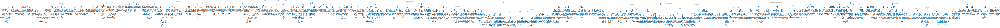

In [20]:
# Visualize the tree.
dot_data = StringIO()
export_graphviz(entr, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names=X_train.columns,class_names = ["No", "Yes"])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

In [21]:
# Let's look at the metrics.

print("Model Entropy - No Max Depth")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred))
print('Balanced accuracy:', metrics.balanced_accuracy_score(y_test,y_pred))
print('Precision score for "Yes":', metrics.precision_score(y_test,y_pred, pos_label = "Yes"))
print('Precision score for "No":', metrics.precision_score(y_test,y_pred, pos_label = "No"))
print('Recall score for "Yes":', metrics.recall_score(y_test,y_pred, pos_label = "Yes"))
print('Recall score for "No":', metrics.recall_score(y_test,y_pred, pos_label = "No"))

Model Entropy - No Max Depth
Accuracy: 0.8297071129707113
Balanced accuracy: 0.604005002347819
Precision score for "Yes": 0.9071881353905036
Precision score for "No": 0.28940783986655544
Recall score for "Yes": 0.8990162379992889
Recall score for "No": 0.3089937666963491


Now, let's tune our model by adjusting max depth.

We will start with the max depth of 5.

In [22]:
entr5 = tree.DecisionTreeClassifier(criterion = 'entropy', random_state=37, max_depth=5)
entr5.fit(X_train, y_train)
y_pred5 = entr5.predict(X_test)

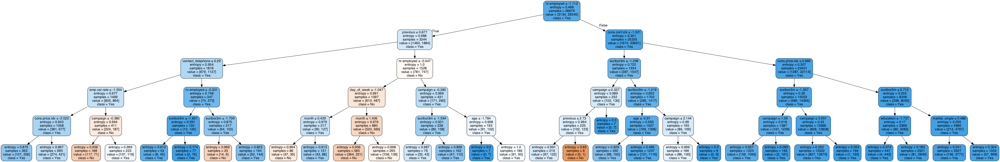

In [23]:
# Visualize the tree.
dot_data = StringIO()
export_graphviz(entr5, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names=X_train.columns,class_names = ["No", "Yes"])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

In [24]:
# Let's look at the metrics.

print("Model Entropy - Max Depth of 5")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred5))
print('Balanced accuracy:', metrics.balanced_accuracy_score(y_test,y_pred5))
print('Precision score for "Yes":', metrics.precision_score(y_test,y_pred5, pos_label = "Yes"))
print('Precision score for "No":', metrics.precision_score(y_test,y_pred5, pos_label = "No"))
print('Recall score for "Yes":', metrics.recall_score(y_test,y_pred5, pos_label = "Yes"))
print('Recall score for "No":', metrics.recall_score(y_test,y_pred5, pos_label = "No"))

Model Entropy - Max Depth of 5
Accuracy: 0.8919456066945607
Balanced accuracy: 0.6002830575705894
Precision score for "Yes": 0.904236732911116
Precision score for "No": 0.6119402985074627
Recall score for "Yes": 0.9815100154083205
Recall score for "No": 0.21905609973285842


And a max depth of 3.

In [25]:
entr3 = tree.DecisionTreeClassifier(criterion = 'entropy', random_state=37, max_depth=3)
entr3.fit(X_train, y_train)
y_pred3 = entr3.predict(X_test)

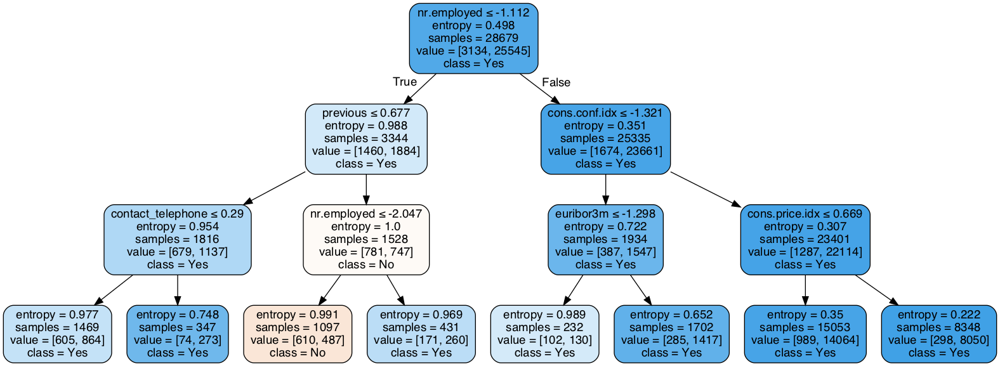

In [26]:
# Visualize the tree.
dot_data = StringIO()
export_graphviz(entr3, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names=X_train.columns,class_names = ["No", "Yes"])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

In [27]:
# Let's look at the metrics.

print("Model Entropy - Max Depth of 3")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred3))
print('Balanced accuracy:', metrics.balanced_accuracy_score(y_test,y_pred3))
print('Precision score for "Yes":', metrics.precision_score(y_test,y_pred3, pos_label = "Yes"))
print('Precision score for "No":', metrics.precision_score(y_test,y_pred3, pos_label = "No"))
print('Recall score for "Yes":', metrics.recall_score(y_test,y_pred3, pos_label = "Yes"))
print('Recall score for "No":', metrics.recall_score(y_test,y_pred3, pos_label = "No"))

Model Entropy - Max Depth of 3
Accuracy: 0.8878661087866109
Balanced accuracy: 0.5890944258060186
Precision score for "Yes": 0.9018003273322422
Precision score for "No": 0.5645569620253165
Recall score for "Yes": 0.9796136067322508
Recall score for "No": 0.19857524487978628


And let's try a final depth of 8.

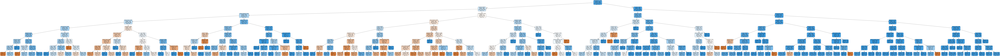

In [28]:
entr8 = tree.DecisionTreeClassifier(criterion = 'entropy', random_state=37, max_depth=8)
entr8.fit(X_train, y_train)
y_pred8 = entr8.predict(X_test)

# Visualize the tree.
dot_data = StringIO()
export_graphviz(entr8, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names=X_train.columns,class_names = ["No", "Yes"])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

In [29]:
# Let's look at the metrics.

print("Model Entropy - Max Depth of 8")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred8))
print('Balanced accuracy:', metrics.balanced_accuracy_score(y_test,y_pred8))
print('Precision score for "Yes":', metrics.precision_score(y_test,y_pred8, pos_label = "Yes"))
print('Precision score for "No":', metrics.precision_score(y_test,y_pred8, pos_label = "No"))
print('Recall score for "Yes":', metrics.recall_score(y_test,y_pred8, pos_label = "Yes"))
print('Recall score for "No":', metrics.recall_score(y_test,y_pred8, pos_label = "No"))

Model Entropy - Max Depth of 8
Accuracy: 0.8888075313807532
Balanced accuracy: 0.6127861829825396
Precision score for "Yes": 0.9072233267064281
Precision score for "No": 0.5592885375494071
Recall score for "Yes": 0.9735688040772786
Recall score for "No": 0.25200356188780054


Running an Entropy Decision Tree at no max depth wasn't predicting as well as running it with a max depth of 5. There isn't much difference between 5 and 8 when looking at precision and recall, so going with the simpler model that uses less computing power is what I would ultimately recommend.

To summarize, Entropy Decision Tree with a Max Depth of 5:

Accuracy score: 89.2%

#### DECISION TREE - GINI IMPURITY

First, let's start with no max depth.

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.146929 to fit



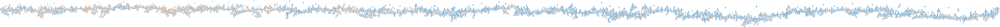

In [30]:
gini = tree.DecisionTreeClassifier(criterion = 'gini', random_state=37)
gini.fit(X_train, y_train)
y_pred = gini.predict(X_test)

# Visualize the tree.
dot_data = StringIO()
export_graphviz(gini, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names=X_train.columns,class_names = ["No", "Yes"])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

In [31]:
# Let's look at the metrics.

print("Model Gini - No Max Depth")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred))
print('Balanced accuracy:', metrics.balanced_accuracy_score(y_test,y_pred))
print('Precision score for "Yes":', metrics.precision_score(y_test,y_pred, pos_label = "Yes"))
print('Precision score for "No":', metrics.precision_score(y_test,y_pred, pos_label = "No"))
print('Recall score for "Yes":', metrics.recall_score(y_test,y_pred, pos_label = "Yes"))
print('Recall score for "No":', metrics.recall_score(y_test,y_pred, pos_label = "No"))

Model Gini - No Max Depth
Accuracy: 0.8268828451882845
Balanced accuracy: 0.6101243716061773
Precision score for "Yes": 0.9088497709187364
Precision score for "No": 0.28988941548183256
Recall score for "Yes": 0.8934455375133341
Recall score for "No": 0.3268032056990205


Decreasing max depth to 8.

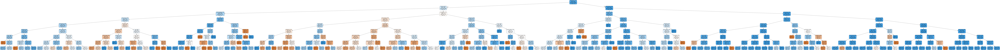

In [32]:
gini8 = tree.DecisionTreeClassifier(criterion = 'gini', random_state=37, max_depth=8)
gini8.fit(X_train, y_train)
y_pred = gini8.predict(X_test)

# Visualize the tree.
dot_data = StringIO()
export_graphviz(gini8, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names=X_train.columns,class_names = ["No", "Yes"])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

In [33]:
# Let's look at the metrics.

print("Model Gini - Max Depth of 8")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred))
print('Balanced accuracy:', metrics.balanced_accuracy_score(y_test,y_pred))
print('Precision score for "Yes":', metrics.precision_score(y_test,y_pred, pos_label = "Yes"))
print('Precision score for "No":', metrics.precision_score(y_test,y_pred, pos_label = "No"))
print('Recall score for "Yes":', metrics.recall_score(y_test,y_pred, pos_label = "Yes"))
print('Recall score for "No":', metrics.recall_score(y_test,y_pred, pos_label = "No"))

Model Gini - Max Depth of 8
Accuracy: 0.8858786610878661
Balanced accuracy: 0.6034073613121864
Precision score for "Yes": 0.9051400838296934
Precision score for "No": 0.5323886639676113
Recall score for "Yes": 0.9726205997392438
Recall score for "No": 0.2341941228851291


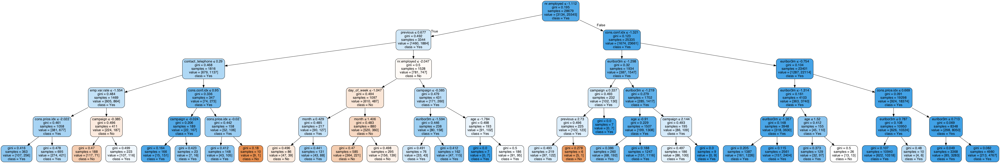

In [34]:
gini5 = tree.DecisionTreeClassifier(criterion = 'gini', random_state=37, max_depth=5)
gini5.fit(X_train, y_train)
y_pred = gini5.predict(X_test)

# Visualize the tree.
dot_data = StringIO()
export_graphviz(gini5, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names=X_train.columns,class_names = ["No", "Yes"])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

In [35]:
# Let's look at the metrics.

print("Model Gini - Max Depth of 5")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred))
print('Balanced accuracy:', metrics.balanced_accuracy_score(y_test,y_pred))
print('Precision score for "Yes":', metrics.precision_score(y_test,y_pred, pos_label = "Yes"))
print('Precision score for "No":', metrics.precision_score(y_test,y_pred, pos_label = "No"))
print('Recall score for "Yes":', metrics.recall_score(y_test,y_pred, pos_label = "Yes"))
print('Recall score for "No":', metrics.recall_score(y_test,y_pred, pos_label = "No"))

Model Gini - Max Depth of 5
Accuracy: 0.8918410041841004
Balanced accuracy: 0.6002237947994623
Precision score for "Yes": 0.9042262749808889
Precision score for "No": 0.6104218362282878
Recall score for "Yes": 0.9813914898660662
Recall score for "No": 0.21905609973285842


Decreasing max depth to 3.

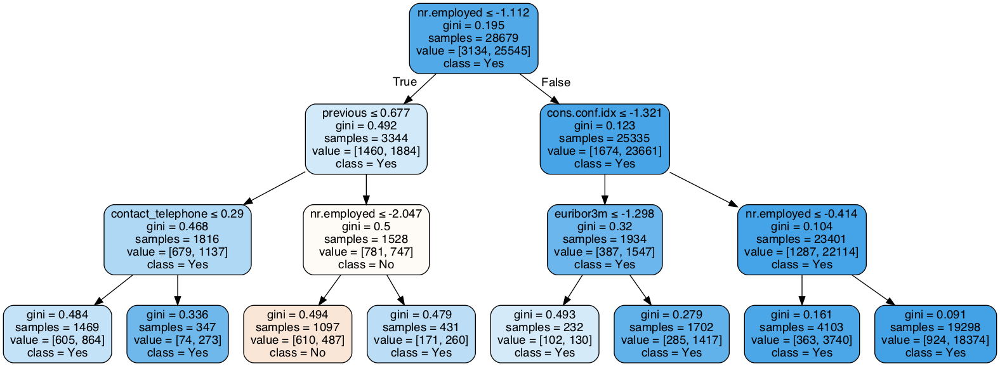

In [36]:
gini3 = tree.DecisionTreeClassifier(criterion = 'gini', random_state=37, max_depth=3)
gini3.fit(X_train, y_train)
y_pred = gini3.predict(X_test)

# Visualize the tree.
dot_data = StringIO()
export_graphviz(gini3, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names=X_train.columns,class_names = ["No", "Yes"])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

In [37]:
# Let's look at the metrics.

print("Model Gini - Max Depth of 3")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred))
print('Balanced accuracy:', metrics.balanced_accuracy_score(y_test,y_pred))
print('Precision score for "Yes":', metrics.precision_score(y_test,y_pred, pos_label = "Yes"))
print('Precision score for "No":', metrics.precision_score(y_test,y_pred, pos_label = "No"))
print('Recall score for "Yes":', metrics.recall_score(y_test,y_pred, pos_label = "Yes"))
print('Recall score for "No":', metrics.recall_score(y_test,y_pred, pos_label = "No"))

Model Gini - Max Depth of 3
Accuracy: 0.8878661087866109
Balanced accuracy: 0.5890944258060186
Precision score for "Yes": 0.9018003273322422
Precision score for "No": 0.5645569620253165
Recall score for "Yes": 0.9796136067322508
Recall score for "No": 0.19857524487978628


Tweaking the Gini Impurity Decision Tree model max depth helped increase accuracy. The difference between the max depth of 3, 5 and 8 was negligible. 

The max depth is the most preferred. Here are the summarized numbers:

Precision score for "Yes": 93.7% // Recall score for "Yes": 96.3%

#### RANDOM FOREST

In [38]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_classification

In [39]:
# Random Forest modeling.
rf = RandomForestClassifier(max_depth = 3, random_state = 37)

rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)

print("Random Forest Model - Max depth 3")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_test,y_pred))
print('Precision score' , metrics.precision_score(y_test,y_pred, pos_label = "Yes"))
print('Recall score' , metrics.recall_score(y_test,y_pred, pos_label = "No"))

Random Forest Model - Max depth 3
Accuracy: 0.8862970711297071
Balanced accuracy: 0.5303095036481698
Precision score 0.8888888888888888
Recall score 0.06500445235975066


In [40]:
rf = RandomForestClassifier(max_depth = 5, random_state = 37)

# Model and fit
rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)

print("Random Forest Model - Max depth 5")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_test,y_pred))
print('Precision score' , metrics.precision_score(y_test,y_pred, pos_label = "Yes"))
print('Recall score' , metrics.recall_score(y_test,y_pred, pos_label = "No"))

Random Forest Model - Max depth 5
Accuracy: 0.8926778242677824
Balanced accuracy: 0.5895046740542311
Precision score 0.9017673208283639
Recall score 0.19323241317898487


In [41]:
rf = RandomForestClassifier(max_depth = 8, random_state = 37)

# Model and fit
rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)

print("Random Forest Model - Max depth 8")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_test,y_pred))
print('Precision score' , metrics.precision_score(y_test,y_pred, pos_label = "Yes"))
print('Recall score' , metrics.recall_score(y_test,y_pred, pos_label = "No"))

Random Forest Model - Max depth 8
Accuracy: 0.8939330543933054
Balanced accuracy: 0.5987072377944286
Precision score 0.9038189533239038
Recall score 0.21282279608192342


## Conclusions

We ran our results through several models. Let's summarize the final, tuned results:
- Logistic Regression: 89.5%
- Decision Tree (Entropy): 89.2% (max depth = 5)
- Decision Tree (Gini): 89.2% (max depth = 5)
- Random Forest: 89.4%

Overall, the models all came in between 89.2% and 89.5%. Neither model did much better than the other, although our Logistic Regression predicted with the highest accuracy of 89.5%.

This is a score that will more than suffice for recommending to this bank's marketing team who to call first for their next campaign. I wouldn't use this kind of accuracy to predict the presence of cancer in a medical setting, but this is a superb score for marketing efforts like this scenario.